In [1]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose

In [2]:
def load_data(pollutant, timestep=None):
    """
    :param pollutant: {"CO", "NO2", "O3", "SO2", "PM10", "PM25"}
    :param timestep: {"D", "M", "Y"}
    """
    df = pd.read_csv(f"R_data/{pollutant}_final.csv", parse_dates=["date"]).set_index("date")
    if not timestep:
        return df
    index_format = {"D": "%Y-%m-%d", "M": "%Y-%m", "Y": "%Y"}
    df = df.groupby(by=["code"]).resample(timestep).mean().dropna().reset_index()
    # df["date"] = df["date"].apply(lambda x: x.strftime(index_format[timestep]))
    return df

In [232]:
df = load_data("NO2")
df.head()

KeyboardInterrupt: 

In [ ]:
daily_df = load_data("NO2", "D")
daily_df.head()

In [4]:
monthly_df = load_data("NO2", "D")
monthly_df.head()

In [9]:
yearly_df = load_data("NO2", "Y")
yearly_df.head()

,code,nox,no2,latitude,longitude
date,,,,,
1997,A30,314.269389,65.982131,51.373553,-0.29197
1998,A30,291.840156,56.801657,51.373553,-0.29197
1999,A30,256.120856,58.470782,51.373553,-0.29197
2000,A30,212.220329,54.903419,51.373553,-0.29197
2001,A30,184.025497,53.486050,51.373553,-0.29197


In [3]:
import gpflow
from gpflow.utilities import print_summary
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler  
import numpy as np
from datetime import datetime

In [49]:
gp_df = load_data("NO2", "M")

In [50]:
gp_df = gp_df.loc[gp_df["date"] > datetime(2010, 1, 1)]

In [51]:
n_months = 12
start_year = gp_df["date"].min().year
gp_df['t'] = gp_df.apply(lambda row: (row.date.year-start_year)*n_months + (row.date.month%n_months), axis=1)
gp_df = gp_df.sort_values("t")

In [52]:
feature_scaler = StandardScaler()
gp_df["norm_lat"] = feature_scaler.fit_transform(gp_df[["latitude"]].values)
gp_df["norm_lon"] = feature_scaler.fit_transform(gp_df[["longitude"]].values)
X = gp_df[["norm_lat", "norm_lon", "t"]].values

gp_df["norm_no2"] = feature_scaler.fit_transform(gp_df[["no2"]].values)
Y = gp_df[["norm_no2"]].values

In [53]:
codes = gp_df["code"].unique()

In [54]:
na = gp_df[gp_df.isna().any(axis=1)]

In [55]:
na.size

0

In [56]:
N, M = X.shape
print(N, M)

12373 3


In [57]:
indices = np.arange(N)
X_train, X_val, Y_train, Y_val, train_indices, test_indices= train_test_split(X, Y, indices, test_size=0.25 )
print(X_train.shape, Y_train.shape, X_val.shape, Y_val.shape, train_indices.shape, test_indices.shape)

(9279, 3) (9279, 1) (3094, 3) (3094, 1) (9279,) (3094,)


In [356]:
class SafeMatern52(gpflow.kernels.Matern52):
    def euclid_dist(self, X, X2):
        r2 = self.square_dist(X, X2)
        return tf.sqrt(r2 + 1e-6)

In [26]:
## KERNEL OPTIONS

#k = SafeMatern52(lengthscales=1, active_dims=[0, 1]) + SafeMatern52(lengthscales=0.1, active_dims=[2])
#, lengthscales=[0.01, 0.01, 0.01])
#k = gpflow.kernels.White() + gpflow.kernels.Periodic(gpflow.kernels.IsotropicStationary(), period=12)
#k = gpflow.kernels.Matern52(active_dims=[2]) + gpflow.kernels.Matern52(active_dims=[0, 1])
#k = SafeMatern52(active_dims=[2]) + SafeMatern52(active_dims=[0,1]) + gpflow.kernels.White(3)
k = gpflow.kernels.AnisotropicStationary(2, active_dims=[0,1], lengthscales=0.3) + gpflow.kernels.Periodic(gpflow.kernels.RBF(1, active_dims=[2], lengthscales=0.3), period=12.0)
           # gpflow.kernels.Stationary(1, active_dims=[2], lengthscales=0.3) +\
# k = gpflow.kernels.White()
#k = gpflow.kernels.White() + gpflow.kernels.Matern52(active_dims=[0]) + gpflow.kernels.Matern52(active_dims=[1]) \
#+ gpflow.kernels.Matern52(active_dims=[2])
#k = gpflow.kernels.SquaredExponential()

In [358]:
print_summary(k)

╒════════════════╤═══════════╤═════════════╤═════════╤═════════════╤═════════╤═════════╤═════════╕
│ name           │ class     │ transform   │ prior   │ trainable   │ shape   │ dtype   │   value │
╞════════════════╪═══════════╪═════════════╪═════════╪═════════════╪═════════╪═════════╪═════════╡
│ White.variance │ Parameter │ Softplus    │         │ True        │ ()      │ float64 │       1 │
╘════════════════╧═══════════╧═════════════╧═════════╧═════════════╧═════════╧═════════╧═════════╛


In [144]:
#gpflow.mean_functions.Zero())
m = gpflow.models.GPR((X_train, Y_train), kernel=k, mean_function=None)#gpflow.mean_functions.Zero())
m.likelihood.variance.assign(0.01)
#m.kernel.lengthscales.assign(np.array([0.3, 0.3, 0.3]))

<tf.Variable 'UnreadVariable' shape=() dtype=float64, numpy=-4.600266525158521>

In [17]:
opt = gpflow.optimizers.Scipy()

In [ ]:
opt_logs = opt.minimize(m.training_loss, m.trainable_variables, options=dict(maxiter=1))
print_summary(m)

2021-11-21 15:56:11.646755: W tensorflow/python/util/util.cc:368] Sets are not currently considered sequences, but this may change in the future, so consider avoiding using them.


In [64]:
%matplotlib inline
import itertools
import numpy as np
import time
import gpflow
import tensorflow as tf
import matplotlib.pyplot as plt
from gpflow.ci_utils import ci_niter

plt.style.use("ggplot")

# for reproducibility of this notebook:
rng = np.random.RandomState(120)
tf.random.set_seed(40)

In [54]:
IL = 500  # Number of inducing locations; bin across months + sites pairs, proportional to # data per site/month?

#k = gpflow.kernels.White(3) +\
#k=  gpflow.kernels.RBF(2, active_dims=[0,1], lengthscales=1.0) + gpflow.kernels.Periodic(gpflow.kernels.RBF(1, active_dims=[2], lengthscales=1.0), period=12.0)
            #gpflow.kernels.RBF(1, active_dims=[2], lengthscales=1.0) +

k = gpflow.kernels.RBF(2, active_dims=[0,1], lengthscales=0.3) + gpflow.kernels.Periodic(gpflow.kernels.RBF(1, active_dims=[2], lengthscales=0.3), period=12.0)

Z = X_train[:IL, :].copy()  # Initialize inducing locations to the first M inputs in the dataset
N_train, M_train = X_train.shape

m = gpflow.models.SVGP(k, gpflow.likelihoods.Gaussian(), Z, num_data=N_train)

In [55]:
elbo = tf.function(m.elbo)
train_data =(X_train, Y_train)

tensor_data = tuple(map(tf.convert_to_tensor, train_data))

minibatch_size = 100

train_dataset = tf.data.Dataset.from_tensor_slices(train_data).repeat().shuffle(N_train)

train_iter = iter(train_dataset.batch(minibatch_size))

ground_truth = elbo(tensor_data).numpy()

In [56]:
%%timeit
elbo(next(train_iter))

11.6 ms ± 489 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [30]:
def get_site_train_test_data(code=None):
    train_df = gp_df.iloc[train_indices, :]
    if code:
        train_df = train_df.loc[train_df["code"] == code]
    train_X = train_df[["norm_lat", "norm_lon", "t"]].values
    train_Y = train_df[["norm_no2"]].values
    
    test_df = gp_df.iloc[test_indices, :]
    if code:
        test_df = test_df.loc[test_df["code"] == code]
    test_X = test_df[["norm_lat", "norm_lon", "t"]].values
    test_Y = test_df[["norm_no2"]].values
    
    return train_X, train_Y, test_X, test_Y

In [43]:
def plot_all_sites(title=""):
    def plot_site(title, code):
        train_X, train_Y, test_X, test_Y = get_site_train_test_data(code)
        if (test_X.shape[0] > 0): # only plot if we have test data
            plt.figure(figsize=(12, 4))
            
            pX = test_X
            pY, pYv = m.predict_y(pX)  # Predict Y values at test locations
            pX_t = pX[:, 2] # only plot time for a given site

            train_X_t = train_X[:, 2] # only plot time for a given site

            plt.plot(train_X_t, train_Y, "x", label="Training points", alpha=0.2)

            pX_t, pY = zip(*sorted(zip(pX_t, pY)))
            (line,) = plt.plot(pX_t, pY, lw=1.5, label="Mean of predictive posterior")
            col = line.get_color()
            plt.fill_between(
                pX_t,
                (pY - 2 * pYv ** 0.5)[:, 0],
                (pY + 2 * pYv ** 0.5)[:, 0],
                color=col,
                alpha=0.6,
                lw=1.5,
            )
            Z = m.inducing_variable.Z.numpy()
            plt.plot(Z, np.zeros_like(Z), "k|", mew=2, label="Inducing locations")
            plt.legend(loc="lower right")
            
            loss = m.training_loss((test_X, test_Y))
            plt.title(f"{title}; val loss (n={test_X.shape[0]})={loss}")
    
    for code in codes:
        plot_site(f"{title} ({code})", code)


2021-11-29 14:59:53.756103: W tensorflow/python/util/util.cc:368] Sets are not currently considered sequences, but this may change in the future, so consider avoiding using them.
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


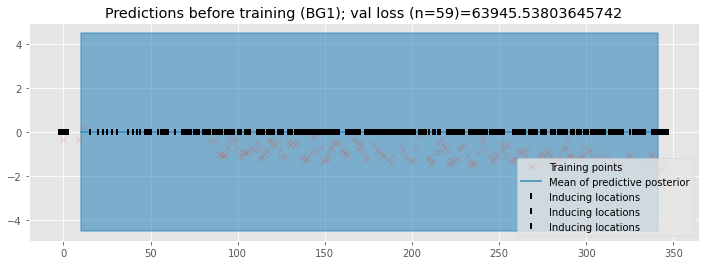

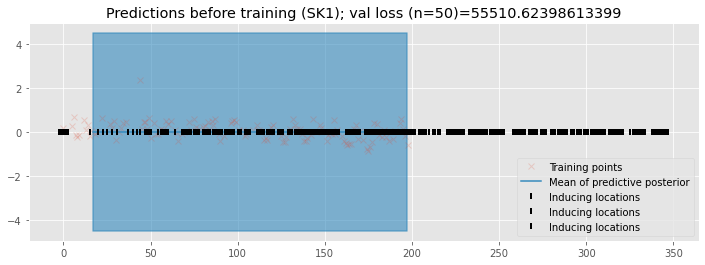

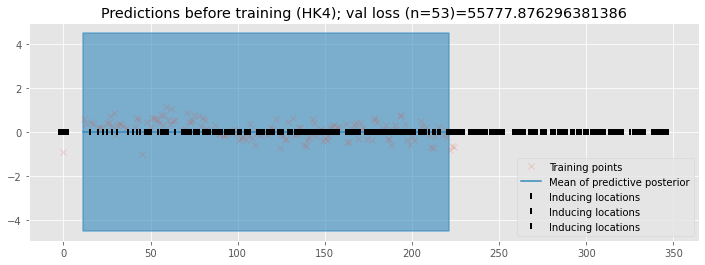

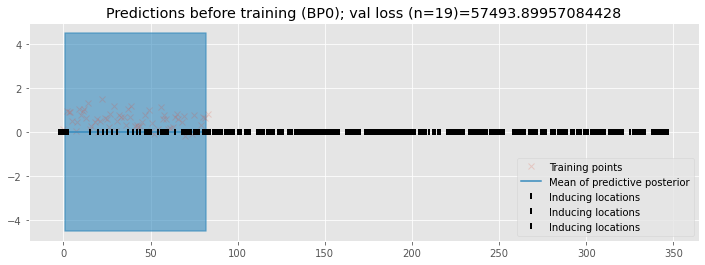

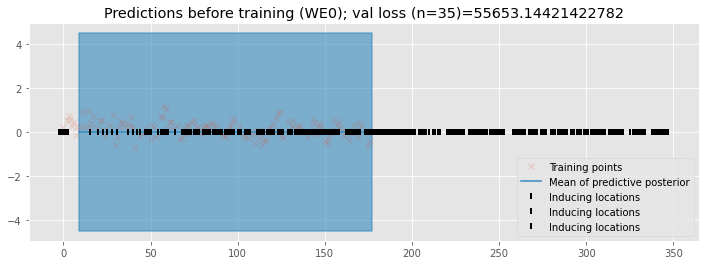

...

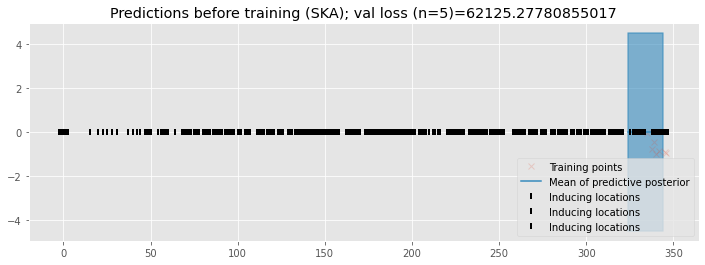

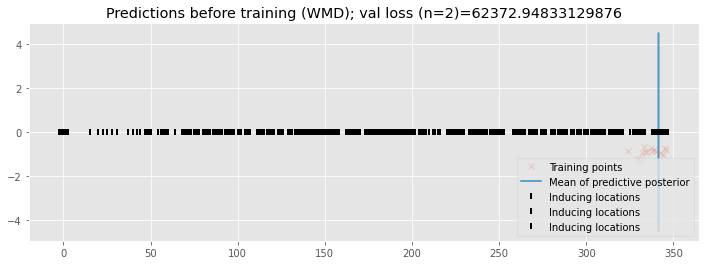

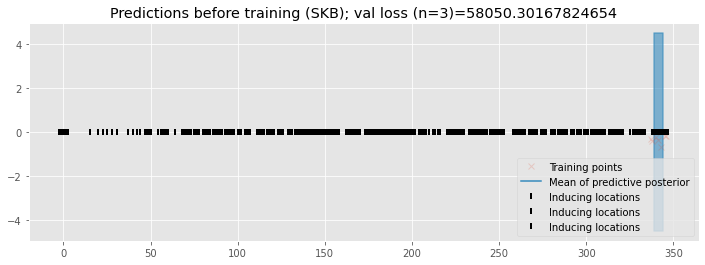

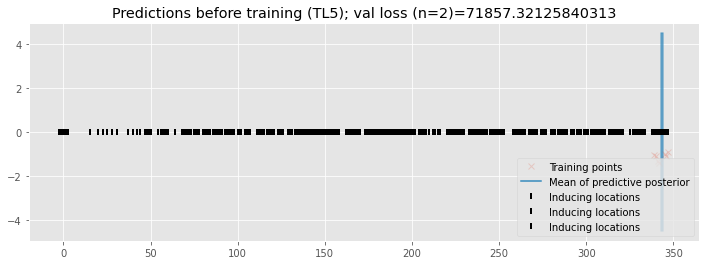

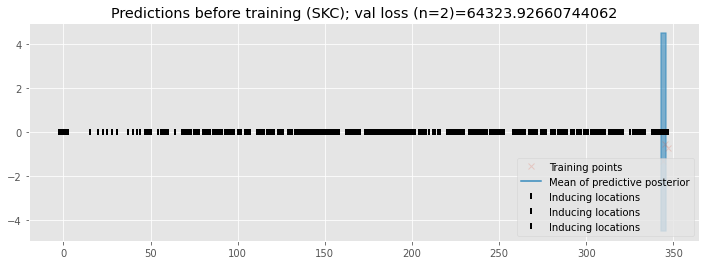

In [22]:
plot_all_sites(title="Predictions before training")

In [19]:
train_X, train_Y, test_X, test_Y = get_site_train_test_data()
#print(f"total loss (n={test_X.shape[0]}) = {m.training_loss((test_X, test_Y))}")

In [45]:
minibatch_size = 100

# We turn off training for inducing point locations
gpflow.set_trainable(m.inducing_variable, False)


def run_adam(model, iterations):
    """
    Utility function running the Adam optimizer

    :param model: GPflow model
    :param interations: number of iterations
    """
    # Create an Adam Optimizer action
    logf = []
    train_iter = iter(train_dataset.batch(minibatch_size))
    training_loss = model.training_loss_closure(train_iter, compile=True)
    optimizer = tf.optimizers.Adam()

    @tf.function
    def optimization_step():
        optimizer.minimize(training_loss, model.trainable_variables)

    for step in range(iterations):
        optimization_step()
        if step % 10 == 0:
            elbo = -training_loss().numpy()
            logf.append(elbo)
    return logf

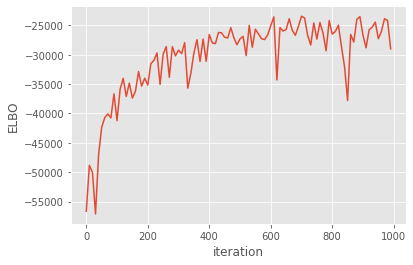

In [46]:
maxiter = ci_niter(1000)

logf = run_adam(m, maxiter)
plt.plot(np.arange(maxiter)[::10], logf)
plt.xlabel("iteration")
_ = plt.ylabel("ELBO")

/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


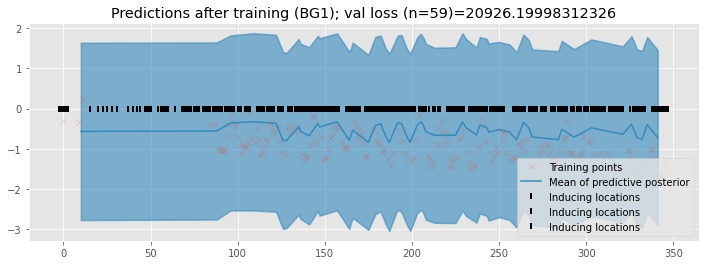

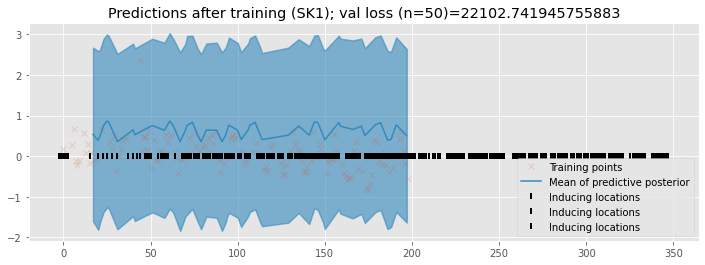

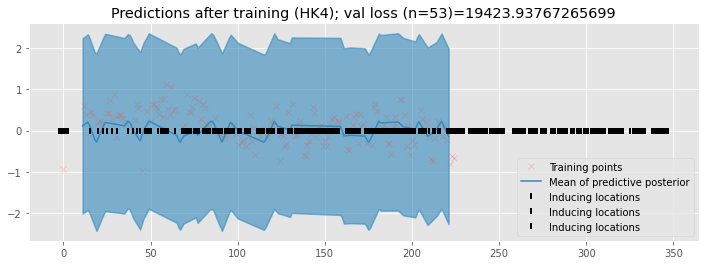

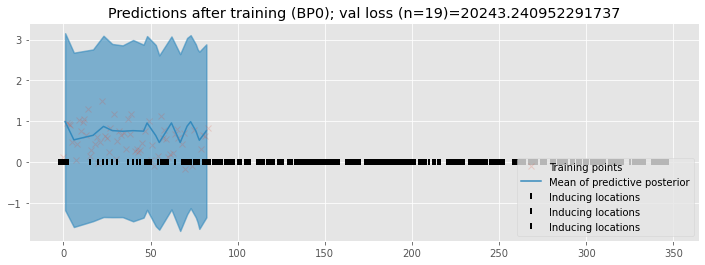

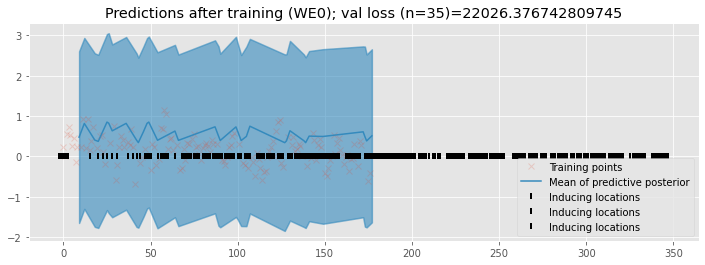

...

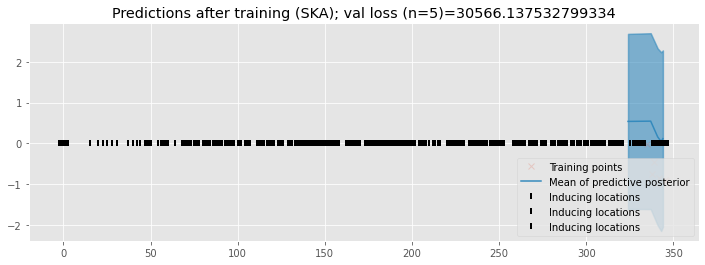

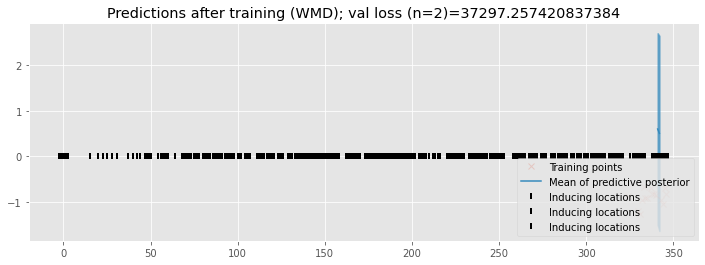

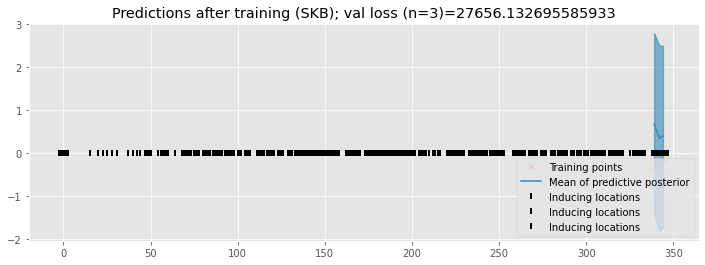

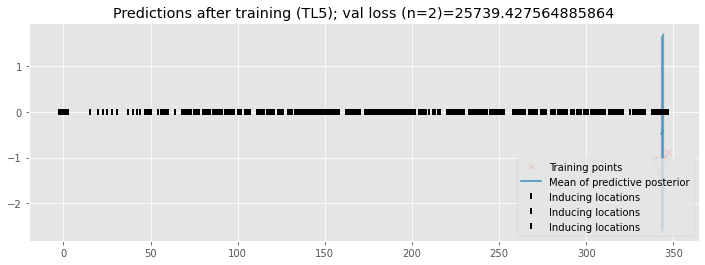

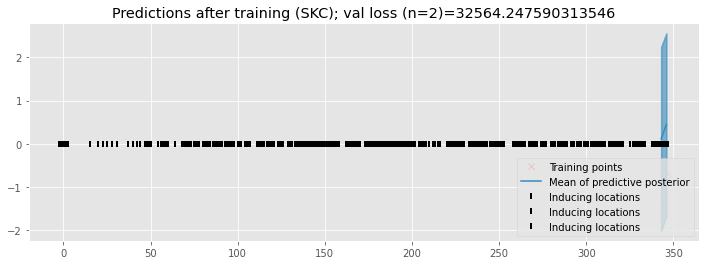

In [48]:
plot_all_sites("Predictions after training")

In [47]:
print(f"total loss (n={test_X.shape[0]}) = {m.training_loss((test_X, test_Y))}")

total loss (n=6199) = 26153.84513209894


In [65]:
from sklearn.gaussian_process import GaussianProcessRegressor
import sklearn.gaussian_process.kernels as kernels

In [66]:
kernel = kernels.ExpSineSquared(periodicity=12)*kernels.RBF([0, 0, 1.0]) + kernels.RBF([1.0, 1.0, 0])#+ kernels.WhiteKernel(1e-3)
#kernel = kernels.ExpSineSquared(periodicity=12)*kernels.RBF([0, 0, 1.0], [[1e-10, 1e5], [1e-10, 1e5], [1e-10, 1e5]]) + kernels.RBF([1.0, 1.0, 0], [[1e-10, 1e5], [1e-10, 1e5], [1e-10, 1e5]])

In [67]:
SK_model = GaussianProcessRegressor(kernel=kernel, alpha=1e-10)

In [68]:
SK_model.fit(X_train, Y_train)

/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/gaussian_process/kernels.py:285: RuntimeWarning: divide by zero encountered in log
  return np.log(np.hstack(theta))
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/gaussian_process/kernels.py:427: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  ConvergenceWarning,
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/gaussian_process/kernels.py:427: ConvergenceWarning: The optimal value found for dimension 1 of parameter k1__k2__length_scale is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  ConvergenceWarning,
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/gaussian_process/kernel

GaussianProcessRegressor(kernel=ExpSineSquared(length_scale=1, periodicity=12) * RBF(length_scale=[0, 0, 1]) + RBF(length_scale=[1, 1, 0]))

In [73]:
def plot_all_SK_sites(title=""):
    def plot_SK_site(title, code):
        train_X, train_Y, test_X, test_Y = get_site_train_test_data(code)
        if (test_X.shape[0] > 0): # only plot if we have test data
            plt.figure(figsize=(12, 4))
            
            pX = np.vstack((train_X, test_X))
            pY, pYv = SK_model.predict(pX, return_std=True)  # Predict Y values at test locations
            pX_t = pX[:, 2] # only plot time for a given site

            train_X_t = train_X[:, 2] # only plot time for a given site

            plt.plot(train_X_t, train_Y, "x", label="Training points", alpha=0.5)
            plt.plot(test_X[:, 2], test_Y, "x", label="Testing points", alpha=1.0)

            pX_t, pY = zip(*sorted(zip(pX_t, pY)))
            pX_t, pY = np.array(pX_t), np.array(pY)
            #print(pX_t.shape, pY.shape, pYv.shape)
            (line,) = plt.plot(pX_t, pY, lw=1.5, label="Mean of predictive posterior")
            col = line.get_color()
            #pY = np.array([pY])
            plt.fill_between(
                pX_t,
                (pY - 2 * pYv ** 0.5)[:, 0],
                (pY + 2 * pYv ** 0.5)[:, 0],
                #color=col,
                alpha=0.6,
                lw=1.5,
            )
            plt.legend(loc="lower right")
            plt.xlabel("Timestep (in months since January, 2010)")
            plt.ylabel("Predicted NO2 Concentration (normalized)")
            
            score = SK_model.score(test_X, test_Y)
            plt.title(f"{title}: score={score} (n={test_X.shape[0]})")
    
    for code in codes:
        plot_SK_site(f"{title} at Site {code}", code)

In [44]:
def get_site_scores(sk_model):
    code_scores = []
    for code in codes:
        X_train, Y_train, X_test, Y_test = get_site_train_test_data(code)
        if X_test.shape[0] > 0 and Y_test.shape[0]:
            code_scores.append(sk_model.score(X_test, Y_test))
    return code_scores


In [42]:
site_scores = get_site_scores(SK_model)
print(site_scores)

/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


[-0.14556761665287543, 0.6091562311707441, 0.5270883916365272, 0.7884490473805017, -0.10139388862449938, 0.33680035769368777, 0.17656836684652533, 0.4856929783618581, 0.6255765305788412, 0.5733691949708359, 0.3627435325398277, -11.59513007102523, 0.5557523711525916, 0.6655183100579023, -2.375401281290779, 0.5665493097629908, -1.1841228007639604, 0.7010710425270198, 0.7910719075234, -0.10097281054800367, 0.5094153348085291, 0.3307176765699582, 0.7784289088765234, 0.4582595508719157, -0.7131764634278541, -1.029247807949878, -1.4175061062845988, 0.7744196767365782, -0.015508374251401058, -0.8489684236578328, -0.7347559940730597, -0.3523962674185628, -0.05667698227981344, 0.791806106072299, 0.4658278529713985, 0.738852463695555, 0.7090747922942129, 0.7599040313393127, 0.5502930768639172, 0.5096618943886999, 0.5257773357805382, 0.8302995123928583, 0.6380142231601229, 0.9116573831593904, 0.13447786588864485, -0.1883316348451447, 0.8184844020191877, 0.926183526276849, -2.354355193841306, 0.49

/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score 

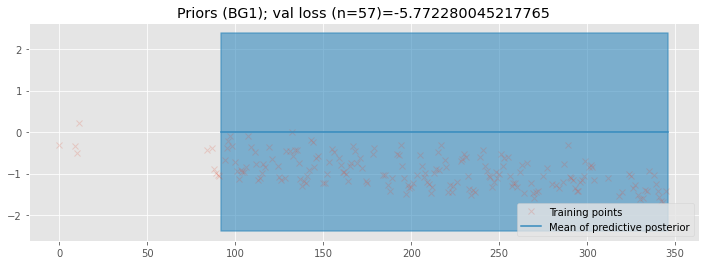

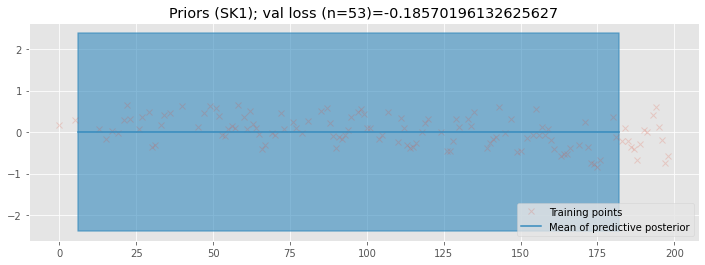

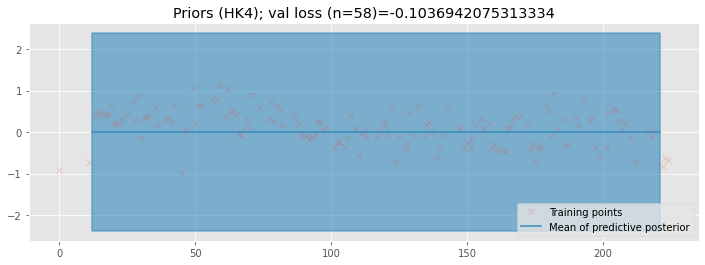

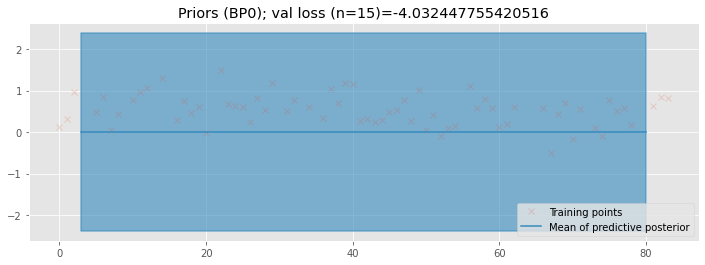

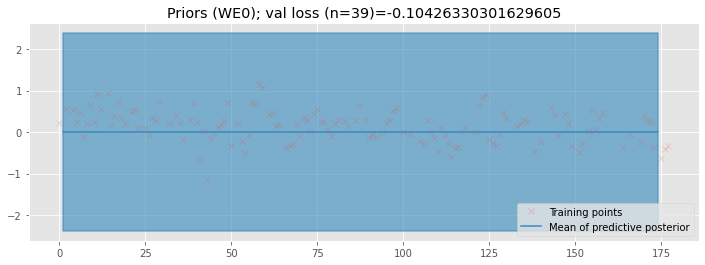

...

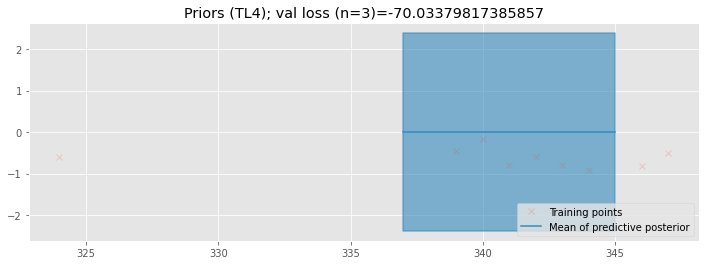

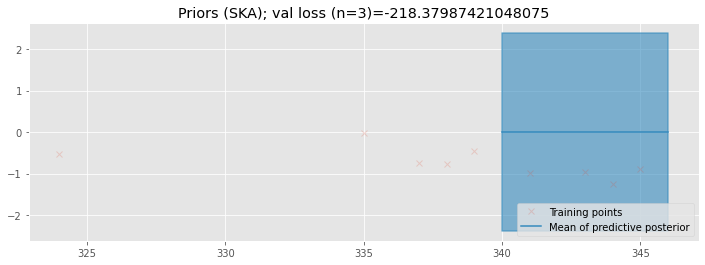

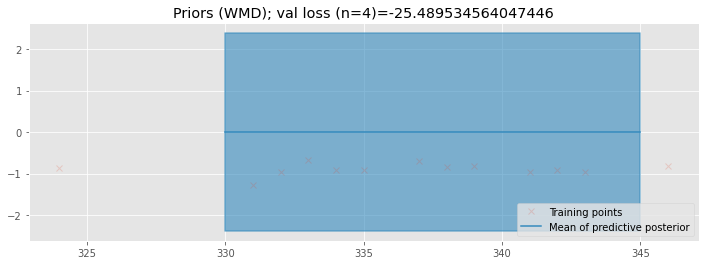

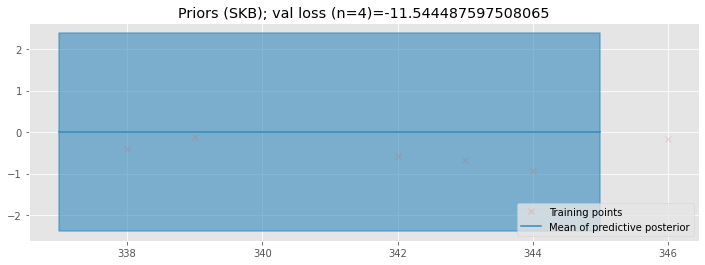

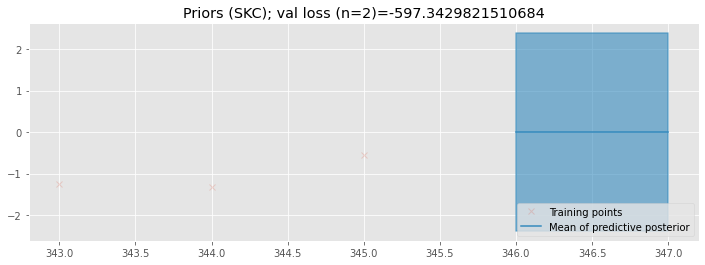

In [55]:
plot_all_SK_sites("Priors")

/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score 

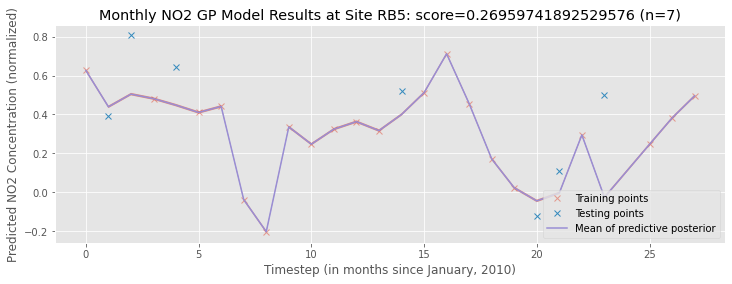

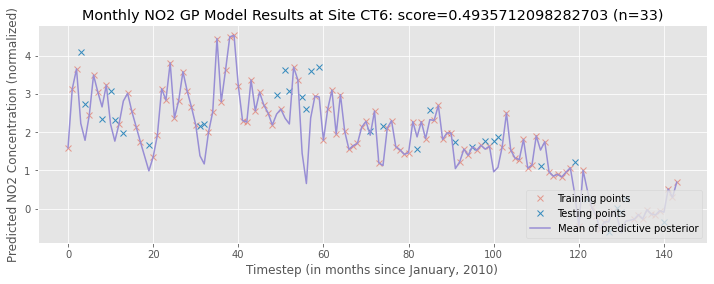

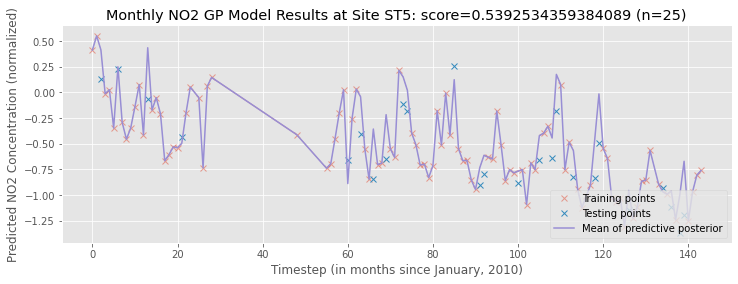

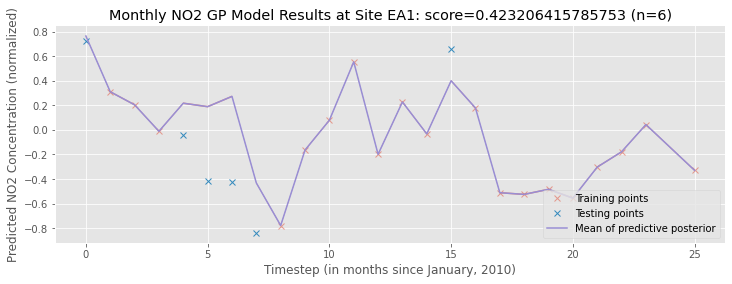

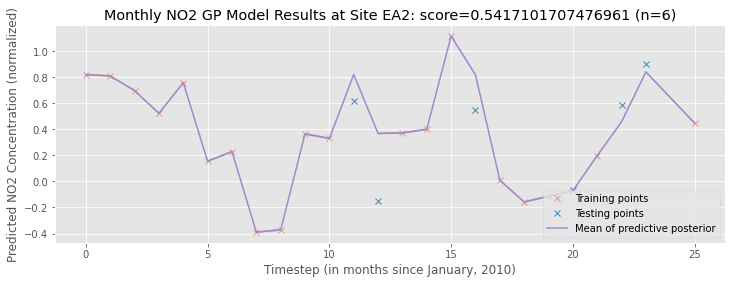

...

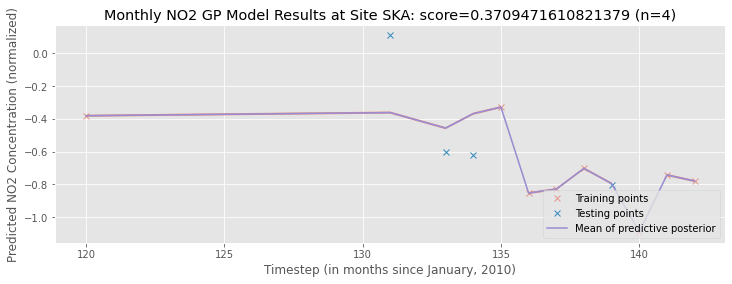

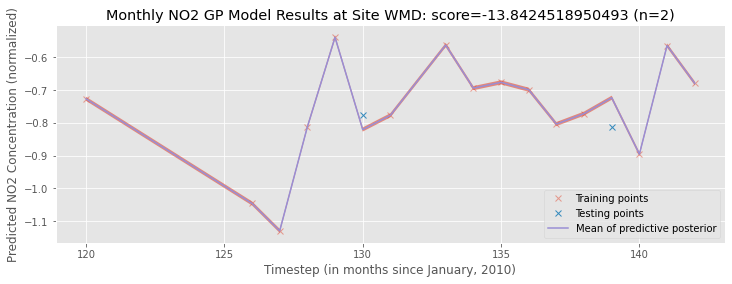

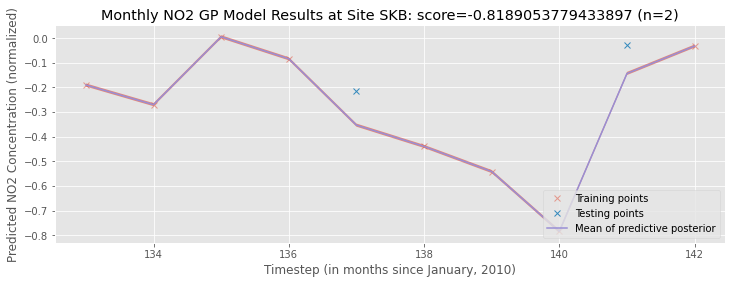

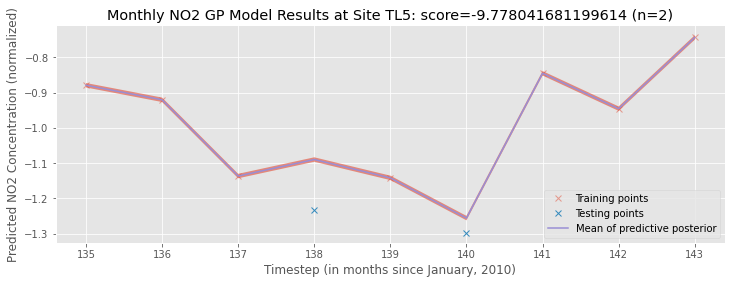

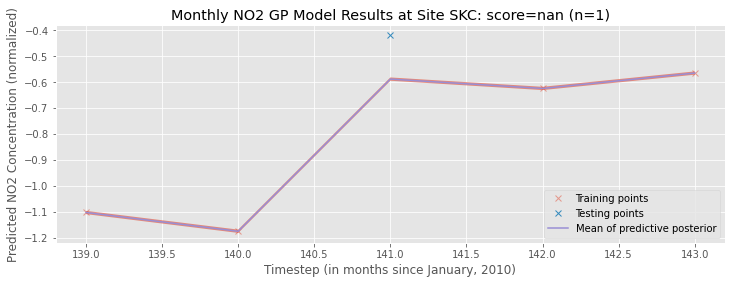

In [74]:
plot_all_SK_sites("Monthly NO2 GP Model Results")

In [69]:
final_train_X, final_train_Y, final_test_X, final_test_Y = get_site_train_test_data()
SK_model.score(final_test_X, final_test_Y)

0.8170634761143328

In [203]:
sites_info_df = pd.read_csv("data/monitoring_sites.csv")
print(sites_info_df.head(10), sites_info_df.shape)

   LocalAuthorityCode    LocalAuthorityName SiteCode  \
0                  27              Richmond      TD0   
1                   1  Barking and Dagenham      BG3   
2                   1  Barking and Dagenham      BG1   
3                   1  Barking and Dagenham      BG2   
4                   2                Barnet      BN2   
5                   2                Barnet      BN3   
6                   2                Barnet      BN1   
7                   3                Bexley      BX5   
8                   3                Bexley      BX2   
9                   3                Bexley      BX0   

                                     SiteName          SiteType  \
0  - National Physical Laboratory, Teddington          Suburban   
1         Barking and Dagenham - North Street          Kerbside   
2           Barking and Dagenham - Rush Green          Suburban   
3       Barking and Dagenham - Scrattons Farm          Suburban   
4                           Barnet - Finchley  U

In [212]:
score_rows = []
unscored_codes = []
for code in codes:
    X_train, Y_train, X_test, Y_test = get_site_train_test_data(code)
    if X_test.shape[0] > 0:
        lat = sites_info_df.loc[sites_info_df['SiteCode'] == code, 'Latitude'].item()
        lon = sites_info_df.loc[sites_info_df['SiteCode'] == code, 'Longitude'].item()
        row = [code, lat, lon, SK_model.score(X_test, Y_test)]
        score_rows.append(row)
    else:
        unscored_codes.append(code)

cols = ["Code", "Latitude", "Longitude", "Score"]
score_df = pd.DataFrame(score_rows, columns=cols)
score_df.head()

/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/alexherrera/opt/anaconda3/envs/london-aq/lib/python3.7/site-packages/sklearn/metrics/_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


,Code,Latitude,Longitude,Score
0,WM0,51.494681,-0.131938,0.815120
1,BG2,51.529389,0.132857,0.850888
2,CT3,51.513847,-0.077766,0.839743
3,LW1,51.445468,-0.020266,0.768557
4,HI0,51.496309,-0.460826,0.704207


In [213]:
unscored_codes

['HS8', 'WMZ']

In [220]:
import plotly.graph_objects as go

In [228]:
fig = go.Figure(data=go.Scattergeo(
        lon = score_df['Longitude'],
        lat = score_df['Latitude'],
        text = score_df['Code'],
        mode = 'markers',
       # marker_color = score_df['Score'],
        marker = dict(
        color = score_df['Score'],
        #colorscale = scl,
        reversescale = False,
        opacity = 0.7,
        size = 2,
        colorbar = dict(
            titleside = "right",
            ticks = "outside",
            showticksuffix = "last"
        )
    )
        ))

fig.update_traces(marker=dict(size=9), selector=dict(mode='markers'))
fig.update_layout(mapbox_style="carto-positron", margin = dict(l = 0, r = 0, t = 40, b = 0))
fig.show()